## Import dataset from Kaggle

In [331]:
import kagglehub

path = kagglehub.dataset_download("phucthaiv02/butterfly-image-classification")

print("Path to dataset files:", path)

Path to dataset files: /Users/keenechung/.cache/kagglehub/datasets/phucthaiv02/butterfly-image-classification/versions/2


## Import Libraries

In [332]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
import keras
from keras import layers, models

In [333]:
plt.style.use('dark_background')

In [334]:
print(tf.__version__)
print(keras.__version__)

2.19.0
3.9.0


## Dataset

In [335]:
df_train = pd.read_csv(path + "/Training_set.csv")

In [336]:
df_test = pd.read_csv(path + "/Testing_set.csv")

In [337]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6499 entries, 0 to 6498
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  6499 non-null   object
 1   label     6499 non-null   object
dtypes: object(2)
memory usage: 101.7+ KB


In [338]:
df_train.head(10)

,filename,label
0,Image_1.jpg,SOUTHERN DOGFACE
1,Image_2.jpg,ADONIS
2,Image_3.jpg,BROWN SIPROETA
3,Image_4.jpg,MONARCH
4,Image_5.jpg,GREEN CELLED CATTLEHEART
5,Image_6.jpg,CAIRNS BIRDWING
6,Image_7.jpg,GREEN CELLED CATTLEHEART
7,Image_8.jpg,EASTERN DAPPLE WHITE
8,Image_9.jpg,BROWN SIPROETA
9,Image_10.jpg,RED POSTMAN


In [339]:
df_train.shape

(6499, 2)

## Butterfly Species

In [340]:
df_train['label'].nunique()

75

In [341]:
label_list = df_train['label'].unique()
label_list.sort()
print(label_list)

['ADONIS' 'AFRICAN GIANT SWALLOWTAIL' 'AMERICAN SNOOT' 'AN 88' 'APPOLLO'
 'ATALA' 'BANDED ORANGE HELICONIAN' 'BANDED PEACOCK' 'BECKERS WHITE'
 'BLACK HAIRSTREAK' 'BLUE MORPHO' 'BLUE SPOTTED CROW' 'BROWN SIPROETA'
 'CABBAGE WHITE' 'CAIRNS BIRDWING' 'CHECQUERED SKIPPER' 'CHESTNUT'
 'CLEOPATRA' 'CLODIUS PARNASSIAN' 'CLOUDED SULPHUR' 'COMMON BANDED AWL'
 'COMMON WOOD-NYMPH' 'COPPER TAIL' 'CRECENT' 'CRIMSON PATCH'
 'DANAID EGGFLY' 'EASTERN COMA' 'EASTERN DAPPLE WHITE'
 'EASTERN PINE ELFIN' 'ELBOWED PIERROT' 'GOLD BANDED' 'GREAT EGGFLY'
 'GREAT JAY' 'GREEN CELLED CATTLEHEART' 'GREY HAIRSTREAK' 'INDRA SWALLOW'
 'IPHICLUS SISTER' 'JULIA' 'LARGE MARBLE' 'MALACHITE' 'MANGROVE SKIPPER'
 'MESTRA' 'METALMARK' 'MILBERTS TORTOISESHELL' 'MONARCH' 'MOURNING CLOAK'
 'ORANGE OAKLEAF' 'ORANGE TIP' 'ORCHARD SWALLOW' 'PAINTED LADY'
 'PAPER KITE' 'PEACOCK' 'PINE WHITE' 'PIPEVINE SWALLOW' 'POPINJAY'
 'PURPLE HAIRSTREAK' 'PURPLISH COPPER' 'QUESTION MARK' 'RED ADMIRAL'
 'RED CRACKER' 'RED POSTMAN' 'RED SPOTTED 

## Endcode labels

In [342]:
# Encode labels into numeric values
label_encoder = LabelEncoder()
df_train['label_encoded'] = label_encoder.fit_transform(df_train['label'])
num_classes = len(label_encoder.classes_)

In [343]:
df_train.head()

,filename,label,label_encoded
0,Image_1.jpg,SOUTHERN DOGFACE,66
1,Image_2.jpg,ADONIS,0
2,Image_3.jpg,BROWN SIPROETA,12
3,Image_4.jpg,MONARCH,44
4,Image_5.jpg,GREEN CELLED CATTLEHEART,33


In [344]:
df_train[['label_encoded','label']].value_counts().sort_index()

label_encoded  label                    
0              ADONIS                       88
1              AFRICAN GIANT SWALLOWTAIL    75
2              AMERICAN SNOOT               74
3              AN 88                        85
4              APPOLLO                      90
                                            ..
70             ULYSES                       84
71             VICEROY                      81
72             WOOD SATYR                   71
73             YELLOW SWALLOW TAIL          75
74             ZEBRA LONG WING              76
Name: count, Length: 75, dtype: int64

## Preview Images

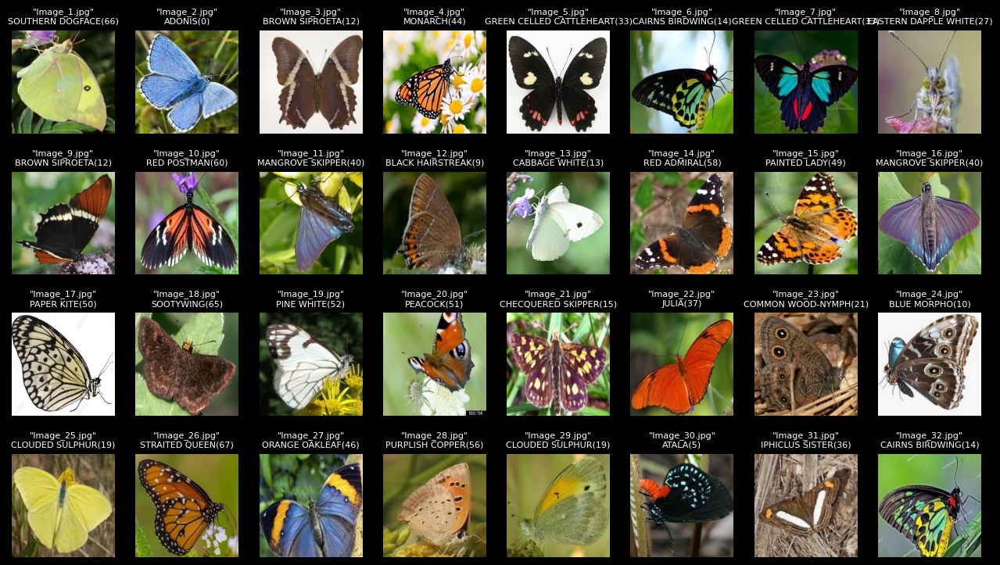

In [345]:
# Preview the first 25 images and their labels
plt.figure(figsize=(16, 9))
for i in range(32):
    filename = df_train.iloc[i]['filename']
    img_path = os.path.join(path + '/train', filename)
    label = df_train.iloc[i]['label']
    code = df_train.iloc[i]['label_encoded']
    img = Image.open(img_path)

    plt.subplot(4, 8, i + 1)
    plt.imshow(img)
    plt.title(f'"{df_train["filename"][i]}"\n{label}({code})', fontsize=8)
    plt.axis('off')

plt.show()

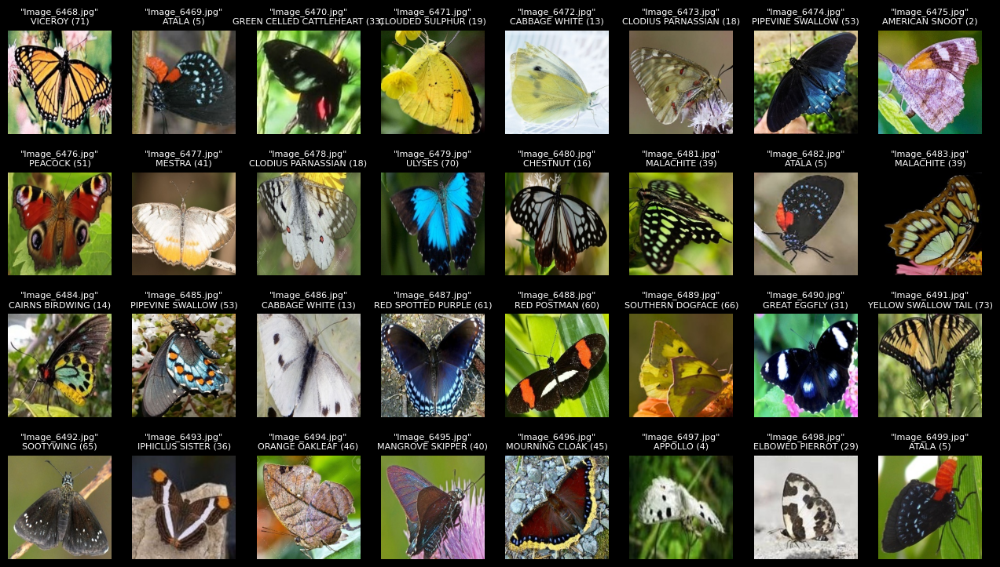

In [346]:
# Preview the last 25 images and their labels
plt.figure(figsize=(16, 9))

start_idx = len(df_train) - 32

for j, i in enumerate(range(start_idx, len(df_train))):
    filename = df_train.iloc[i]['filename']
    img_path = os.path.join(path, 'train', filename)
    label = df_train.iloc[i]['label']
    code = df_train.iloc[i]['label_encoded']
    img = Image.open(img_path)

    plt.subplot(4, 8, j + 1)
    plt.imshow(img)
    plt.title(f'"{df_train["filename"][i]}"\n{label} ({code})', fontsize=8)
    plt.axis('off')

plt.show()

In [347]:
# Set base path to your train images folder
train_img_dir = os.path.join(path, "train")
train_img_dir

'/Users/keenechung/.cache/kagglehub/datasets/phucthaiv02/butterfly-image-classification/versions/2/train'

In [348]:
# Create full image paths
df_train['image_path'] = df_train['filename'].apply(lambda x: os.path.join(train_img_dir, x))

In [349]:
df_train.head()

,filename,label,label_encoded,image_path
0,Image_1.jpg,SOUTHERN DOGFACE,66,/Users/keenechung/.cache/kagglehub/datasets/ph...
1,Image_2.jpg,ADONIS,0,/Users/keenechung/.cache/kagglehub/datasets/ph...
2,Image_3.jpg,BROWN SIPROETA,12,/Users/keenechung/.cache/kagglehub/datasets/ph...
3,Image_4.jpg,MONARCH,44,/Users/keenechung/.cache/kagglehub/datasets/ph...
4,Image_5.jpg,GREEN CELLED CATTLEHEART,33,/Users/keenechung/.cache/kagglehub/datasets/ph...


In [350]:
# Convert to TensorFlow Dataset
image_paths = df_train['image_path'].values
labels = df_train['label_encoded'].values

In [351]:
# Create a TensorFlow dataset from file paths and labels
train_ds = tf.data.Dataset.from_tensor_slices((image_paths, labels))

In [352]:
# Function to load and preprocess image
def preprocess_image(image_path, label):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)      # Decode JPEG
    image = tf.image.resize(image, [128, 128])           # Resize to 128x128
    image = image / 255.0                                # Normalize to [0, 1]
    return image, tf.one_hot(label, depth=len(label_encoder.classes_))  # One-hot encode labels

# Apply preprocessing
train_ds = train_ds.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)

# Shuffle, batch, and prefetch
train_ds = train_ds.shuffle(buffer_size=1000).batch(32).prefetch(tf.data.AUTOTUNE)

## CNN Model (Convolutional Neural Network)

In [353]:
num_classes = len(label_encoder.classes_)  # Total number of butterfly species

model = models.Sequential([
    layers.Input(shape=(128, 128, 3)),
    
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(num_classes, activation='softmax')  # Multi-class classification
])

model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 128)            │     3,211,392 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 75)             │         9,675 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,314,315 (12.64 MB)

 Trainable params: 3,314,315 (12.64 MB)

 Non-trainable params: 0 (0.00 B)

In [354]:
# Train the model
history = model.fit(
    train_ds,
    epochs=20  # You can adjust this number
)

Epoch 1/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 66ms/step - accuracy: 0.0554 - loss: 4.0566
Epoch 2/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 67ms/step - accuracy: 0.3010 - loss: 2.7220
Epoch 3/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 68ms/step - accuracy: 0.4547 - loss: 1.9929
Epoch 4/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 66ms/step - accuracy: 0.5841 - loss: 1.4811
Epoch 5/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 67ms/step - accuracy: 0.6807 - loss: 1.0471
Epoch 6/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 15s 73ms/step - accuracy: 0.7618 - loss: 0.7669
Epoch 7/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 15s 71ms/step - accuracy: 0.8160 - loss: 0.5815
Epoch 8/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 70ms/step - accuracy: 0.8690 - loss: 0.4256
Epoch 9/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 67ms/step - accuracy: 0.8827 - loss: 0.3925
Epoch 10/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 68ms/step - accuracy: 0.8922 - loss: 0.3186
Epoch 11/20
204/204 ━━━━━━━━━━━━━━━━━━━━ 14s 68ms/step - accuracy: 0.9143 - loss: 0.2641
Epoch 12/20
204/204 ━━━━━━━━━━

## Testing Set

In [355]:
df_test.head()

,filename
0,Image_1.jpg
1,Image_2.jpg
2,Image_3.jpg
3,Image_4.jpg
4,Image_5.jpg


In [356]:
df_test.shape

(2786, 1)

In [357]:
test_img_dir = os.path.join(path, "test")
test_img_dir

'/Users/keenechung/.cache/kagglehub/datasets/phucthaiv02/butterfly-image-classification/versions/2/test'

In [358]:
# Create full test image paths
df_test['image_path'] = df_test['filename'].apply(lambda x: os.path.join(test_img_dir, x))
test_paths = df_test['image_path'].values

In [359]:
# Create tf.data.Dataset for test images (no labels)
test_ds = tf.data.Dataset.from_tensor_slices(test_paths)

In [360]:
# Preprocessing function (just images, no label)
def preprocess_test_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [128, 128])
    image = image / 255.0
    return image

# Apply preprocessing
test_ds = test_ds.map(preprocess_test_image, num_parallel_calls=tf.data.AUTOTUNE)
test_ds = test_ds.batch(32).prefetch(tf.data.AUTOTUNE)

In [361]:
# Get model predictions
predictions = model.predict(test_ds)
predictions

88/88 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step


array([[4.73058521e-04, 2.76949644e-11, 2.69599104e-06, ...,
        1.03500515e-08, 7.94172020e-12, 8.36173036e-14],
       [2.68345828e-25, 3.11744889e-20, 7.32355367e-19, ...,
        5.03138297e-27, 1.42735195e-15, 4.49840703e-17],
       [9.44850564e-01, 8.12225220e-09, 5.46098704e-08, ...,
        1.00426641e-05, 1.02038541e-06, 5.83497972e-10],
       ...,
       [6.48302701e-13, 3.25769905e-18, 3.32328158e-11, ...,
        1.09992857e-06, 7.51118959e-11, 3.05655665e-18],
       [9.79164980e-08, 2.23127822e-10, 3.28019098e-07, ...,
        9.26805258e-01, 2.29079511e-08, 1.05402373e-17],
       [2.37574298e-15, 6.11986578e-19, 5.78942784e-17, ...,
        2.36482415e-27, 3.40163799e-17, 5.26805441e-18]], dtype=float32)

In [362]:
predicted_classes = tf.argmax(predictions, axis=1).numpy()
predicted_classes

array([38, 24,  0, ..., 19, 72,  7])

In [363]:
# Map predicted labels back to original class names
predicted_labels = label_encoder.inverse_transform(predicted_classes)
predicted_labels


array(['LARGE MARBLE', 'CRIMSON PATCH', 'ADONIS', ..., 'CLOUDED SULPHUR',
       'WOOD SATYR', 'BANDED PEACOCK'], dtype=object)

In [364]:
# Add predictions to DataFrame
df_test['predicted_label'] = predicted_labels
df_test.head()

,filename,image_path,predicted_label
0,Image_1.jpg,/Users/keenechung/.cache/kagglehub/datasets/ph...,LARGE MARBLE
1,Image_2.jpg,/Users/keenechung/.cache/kagglehub/datasets/ph...,CRIMSON PATCH
2,Image_3.jpg,/Users/keenechung/.cache/kagglehub/datasets/ph...,ADONIS
3,Image_4.jpg,/Users/keenechung/.cache/kagglehub/datasets/ph...,IPHICLUS SISTER
4,Image_5.jpg,/Users/keenechung/.cache/kagglehub/datasets/ph...,MILBERTS TORTOISESHELL


## Prediction

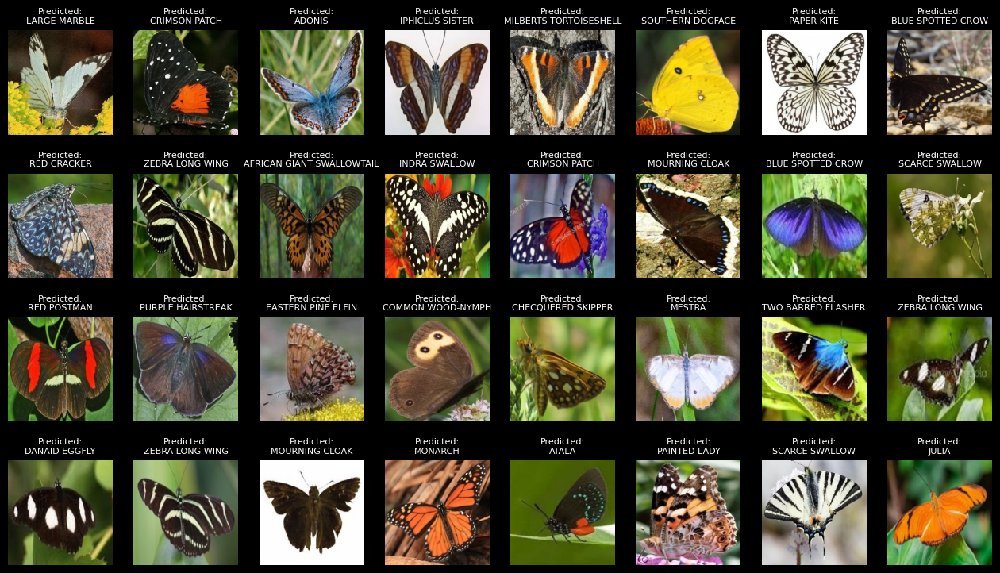

In [365]:
# Choose how many images to display
predict_num_images = 32

# Grab first few rows from df_test
sample_df = df_test.head(predict_num_images)

# Create a grid of images
plt.figure(figsize=(16, 9))
for i, row in enumerate(sample_df.itertuples()):
    img = mpimg.imread(row.image_path)
    plt.subplot(4, 8, i + 1)
    plt.imshow(img)
    plt.title(f"Predicted:\n{row.predicted_label}", fontsize=8)
    plt.axis('off')

plt.show()

## Getting to know the species

ADONIS


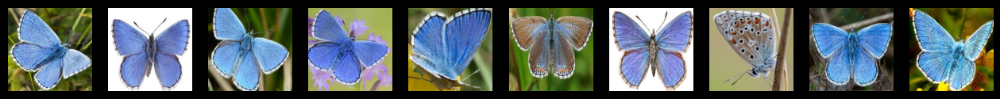

AFRICAN GIANT SWALLOWTAIL


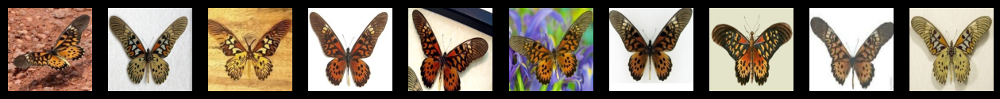

AMERICAN SNOOT


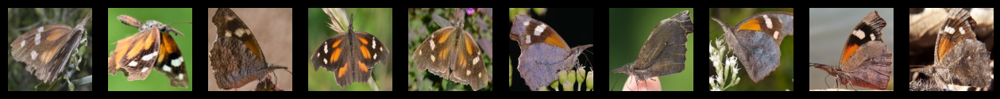

AN 88


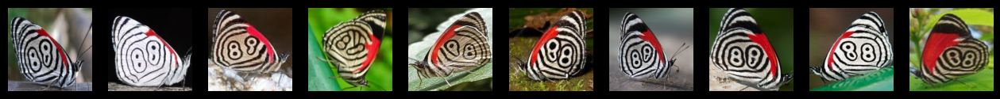

APPOLLO


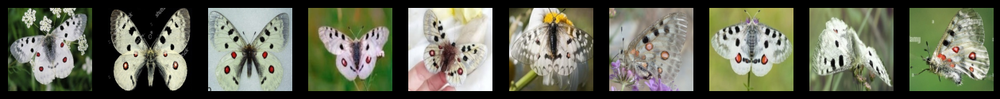

ATALA


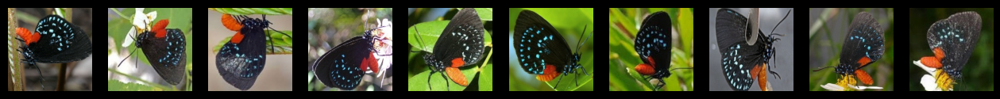

BANDED ORANGE HELICONIAN


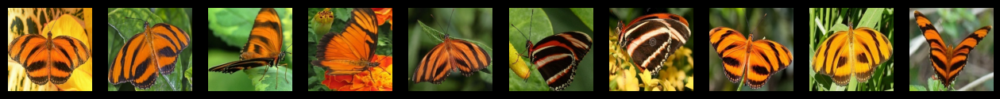

BANDED PEACOCK


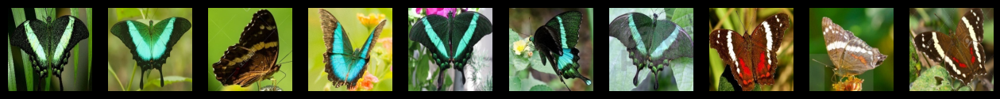

BECKERS WHITE


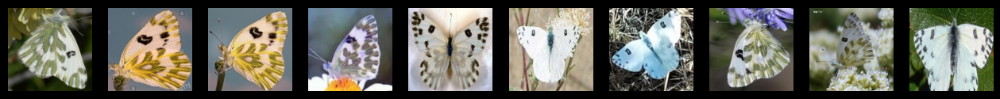

BLACK HAIRSTREAK


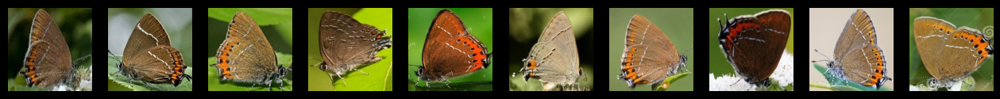

BLUE MORPHO


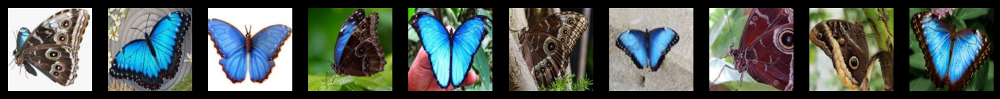

BLUE SPOTTED CROW


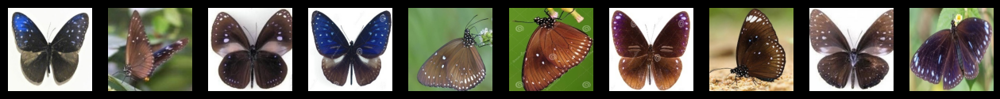

BROWN SIPROETA


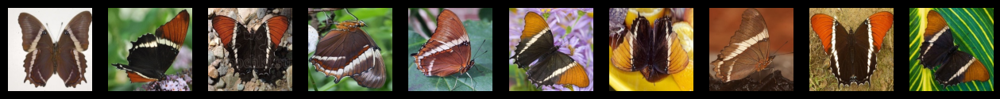

CABBAGE WHITE


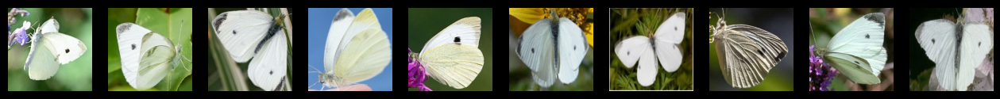

CAIRNS BIRDWING


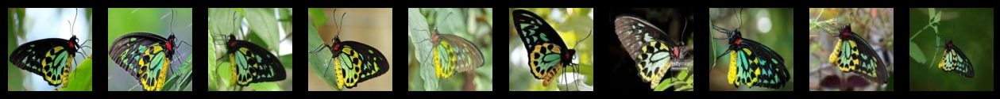

CHECQUERED SKIPPER


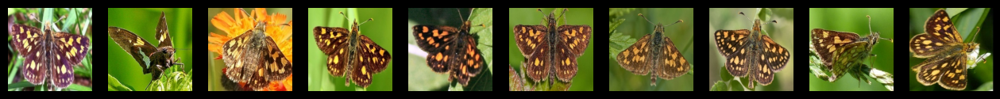

CHESTNUT


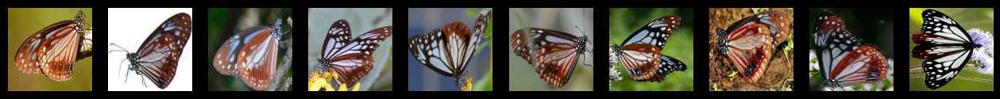

CLEOPATRA


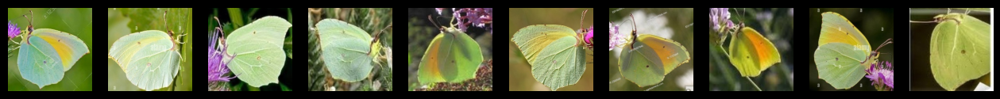

CLODIUS PARNASSIAN


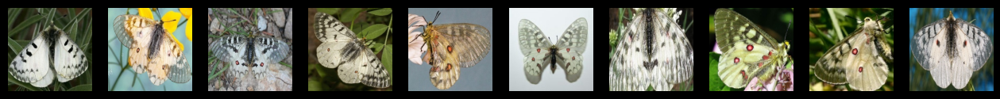

CLOUDED SULPHUR


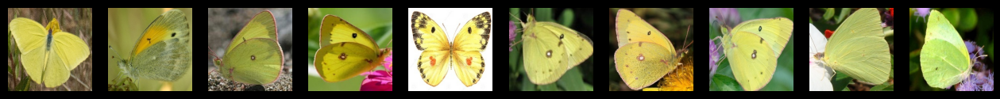

COMMON BANDED AWL


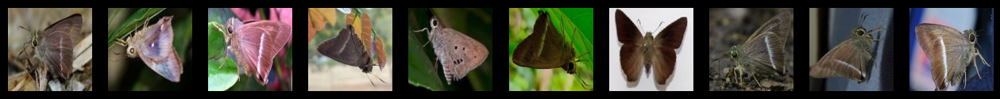

COMMON WOOD-NYMPH


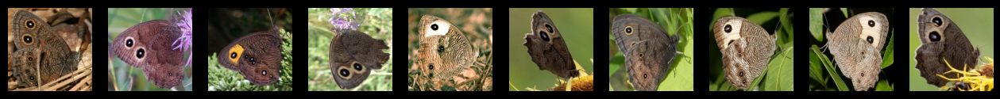

COPPER TAIL


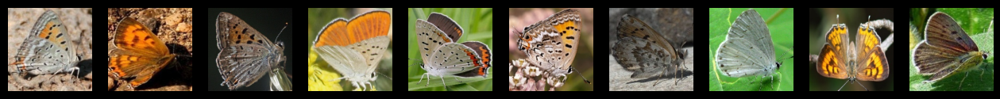

CRECENT


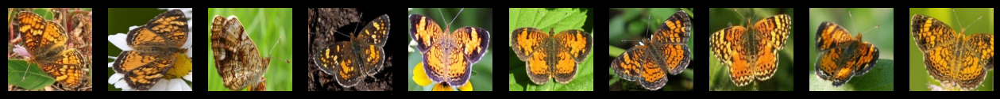

CRIMSON PATCH


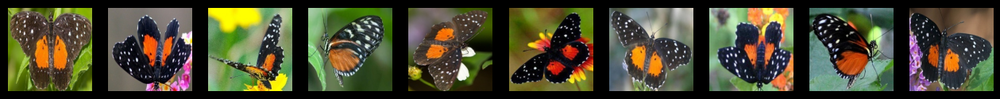

DANAID EGGFLY


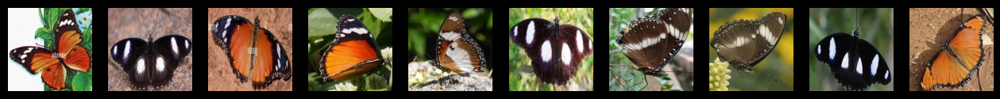

EASTERN COMA


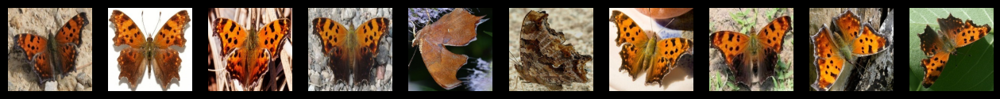

EASTERN DAPPLE WHITE


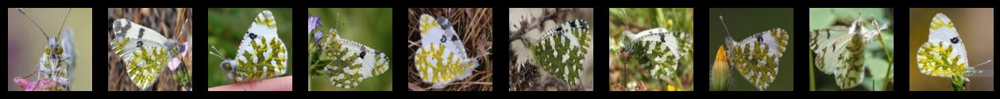

EASTERN PINE ELFIN


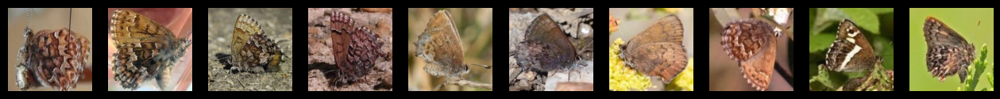

ELBOWED PIERROT


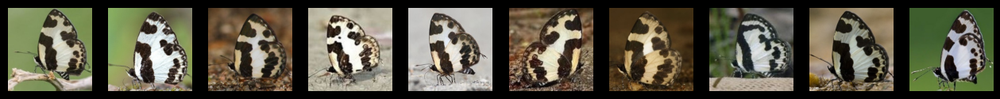

GOLD BANDED


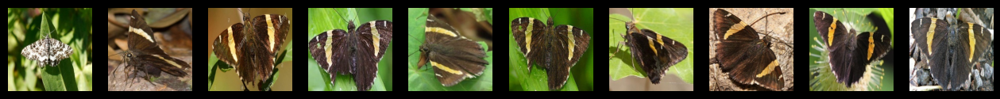

GREAT EGGFLY


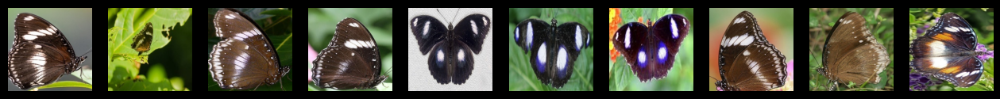

GREAT JAY


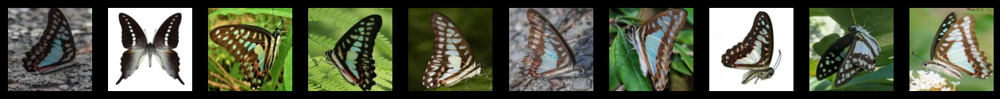

GREEN CELLED CATTLEHEART


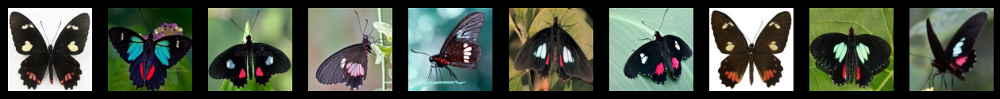

GREY HAIRSTREAK


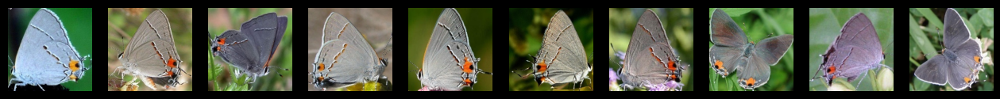

INDRA SWALLOW


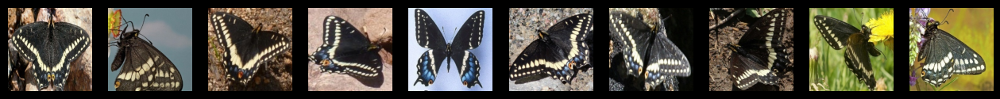

IPHICLUS SISTER


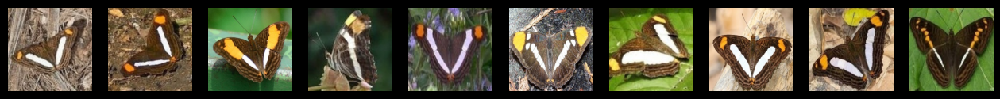

JULIA


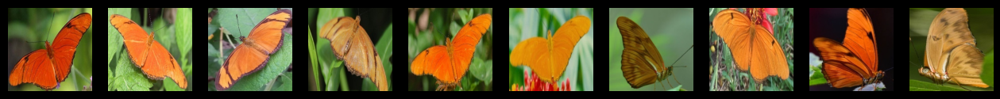

LARGE MARBLE


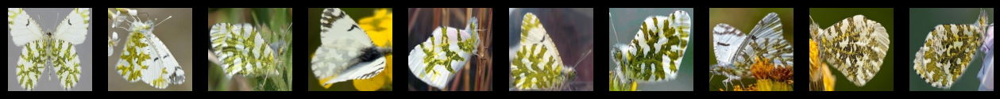

MALACHITE


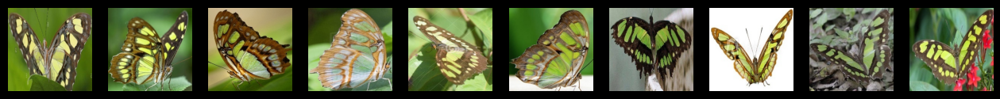

MANGROVE SKIPPER


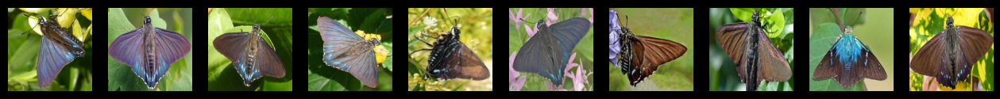

MESTRA


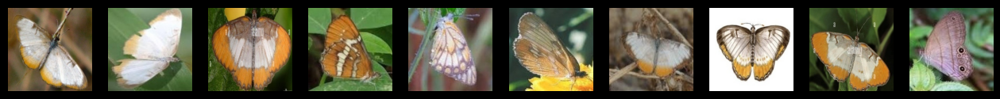

METALMARK


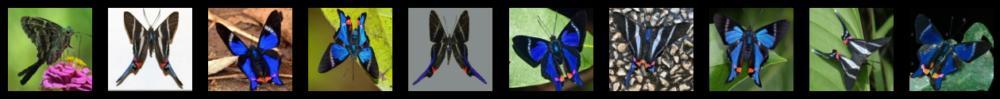

MILBERTS TORTOISESHELL


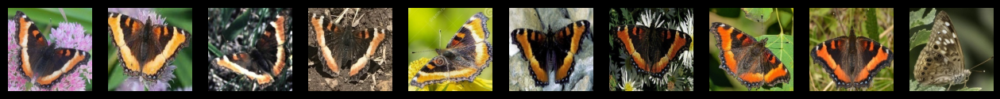

MONARCH


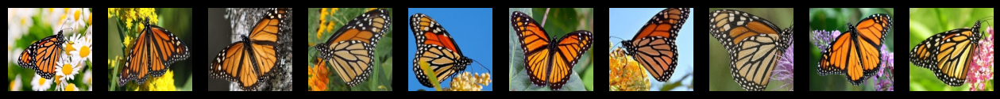

MOURNING CLOAK


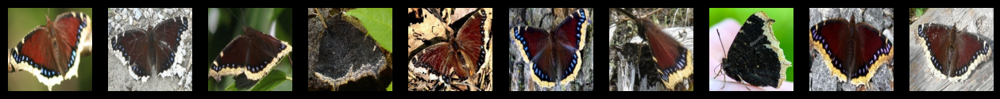

ORANGE OAKLEAF


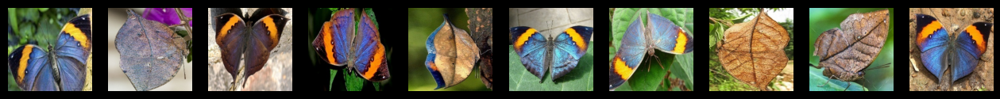

ORANGE TIP


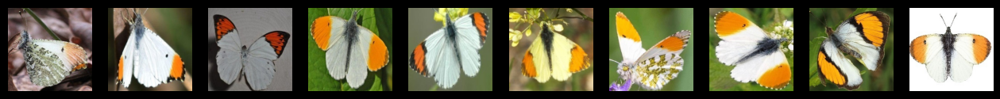

ORCHARD SWALLOW


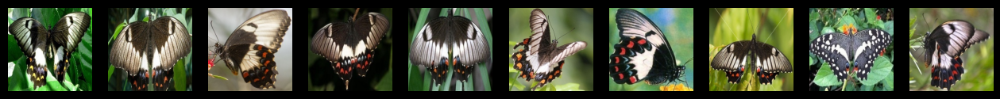

PAINTED LADY


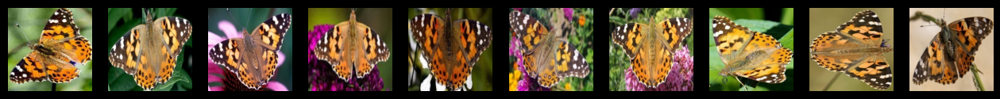

PAPER KITE


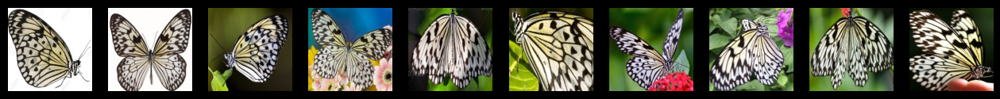

PEACOCK


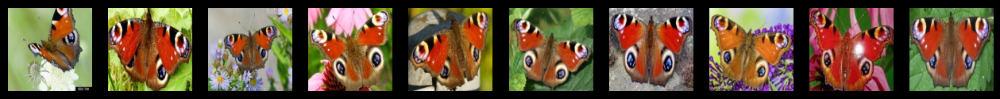

PINE WHITE


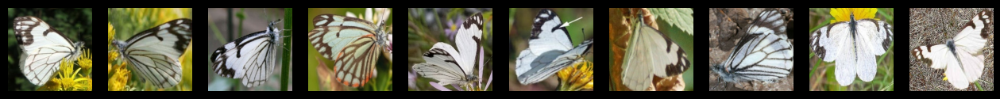

PIPEVINE SWALLOW


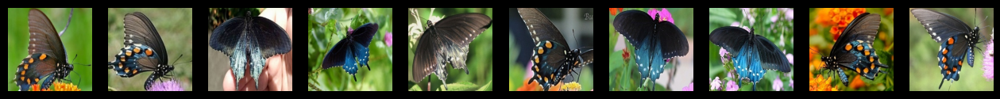

POPINJAY


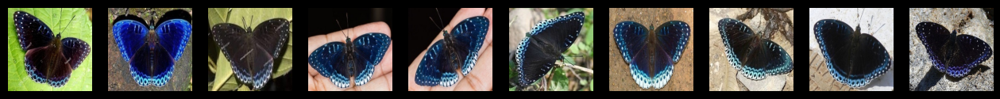

PURPLE HAIRSTREAK


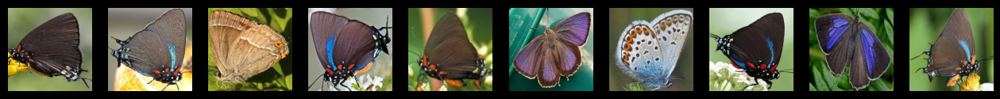

PURPLISH COPPER


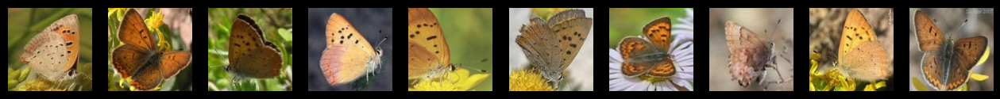

QUESTION MARK


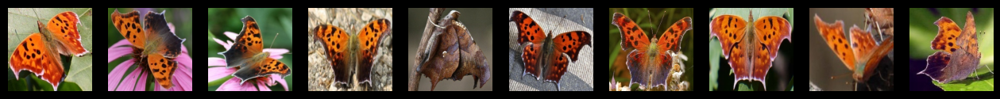

RED ADMIRAL


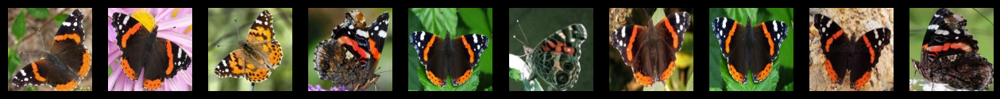

RED CRACKER


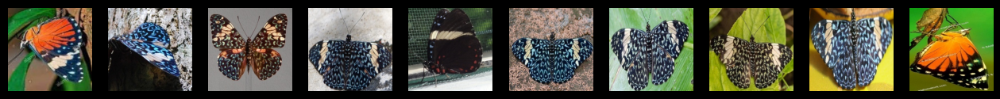

RED POSTMAN


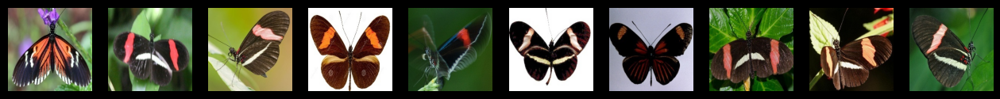

RED SPOTTED PURPLE


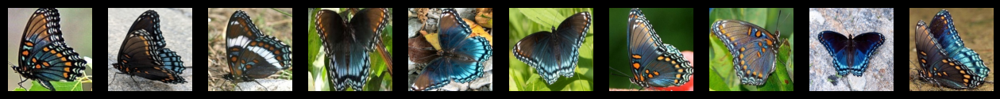

SCARCE SWALLOW


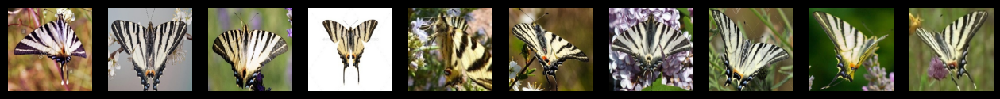

SILVER SPOT SKIPPER


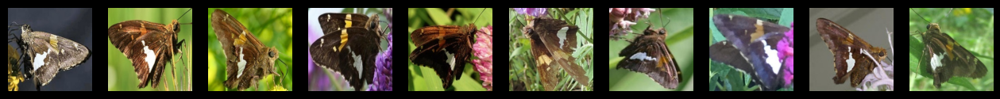

SLEEPY ORANGE


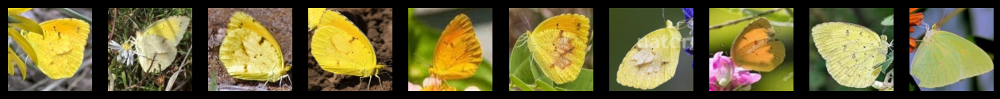

SOOTYWING


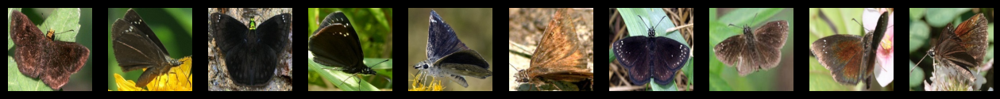

SOUTHERN DOGFACE


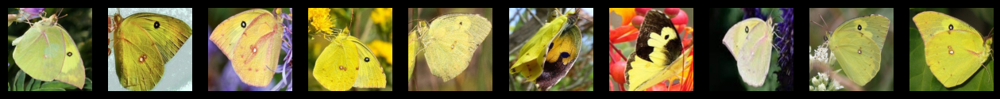

STRAITED QUEEN


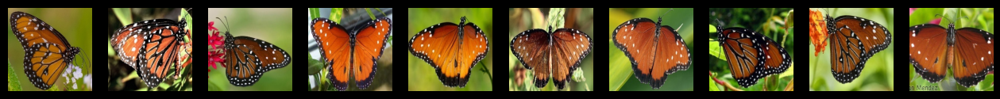

TROPICAL LEAFWING


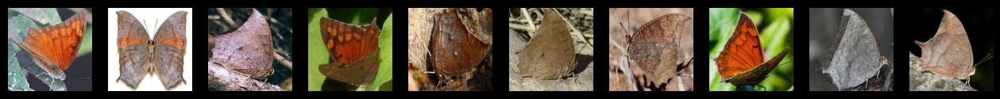

TWO BARRED FLASHER


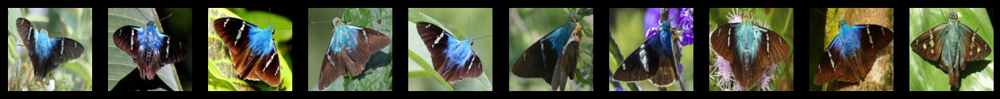

ULYSES


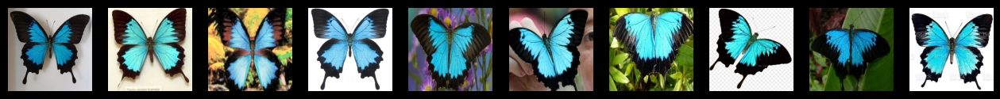

VICEROY


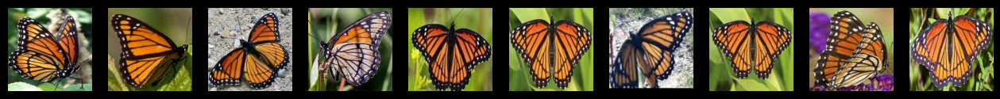

WOOD SATYR


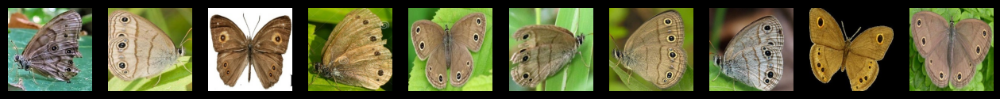

YELLOW SWALLOW TAIL


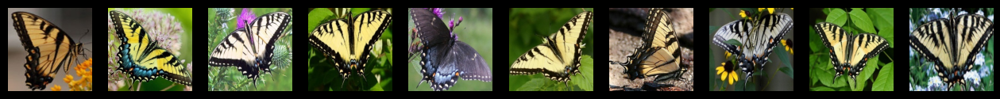

ZEBRA LONG WING


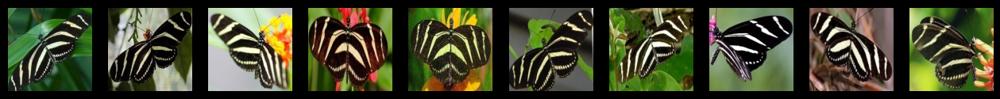

In [366]:
label_list = sorted(list(df_train['label'].unique()))
species_num_images = 10

for label in label_list:
    df_specie = df_train[df_train['label'] == label]
    print(label)
    plt.figure(figsize=(16, 2))
    for i, row in enumerate(df_specie.head(species_num_images).itertuples()):
        img = mpimg.imread(row.image_path)
        plt.subplot(1, 10, i + 1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()